<a href="https://colab.research.google.com/github/PriyanshSharma01/Mould-Breakout-Prediction/blob/main/Mould_Breakout_Prediction_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

We will make a Artificial Neural Network with Backpropagation algorithm to find whether there will be a mould breakout or not.

We will make neural network model in python language.
We will be using libraries like numpy, pandas, matlplotlib, seaborn etc and 
will work on keras library with tensorflow as backend.

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
 %reload_ext tensorboard

In [ ]:
import tensorboard
tensorboard.__version__

'2.4.1'

In [ ]:
rm -rf ./logs/

In [ ]:
import numpy as np
import pandas as pd
import random
import os
import tensorflow as tf


In [ ]:
import datetime

In [ ]:
import seaborn as sns 
import matplotlib.pyplot as plt
%matplotlib inline

Seeding everything so that there is no change in the values if it is run another time.

In [ ]:
def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    tf.random.set_seed(seed)
seed = 42
seed_everything(seed)

In [ ]:
dataset = pd.read_csv("/content/Raw Data (1).csv")

In [ ]:
dataset.head(10)

,T1,T2,T3,T4,T5,T6,T7,T8,CS,ML,Alarm
0,6,8,5,15,6,-3,112,13,77,174,1
1,105,7,10,203,17,17,93,-3,99,180,1
2,105,-1,9,197,-4,-3,95,5,98,180,1
3,101,17,12,207,20,23,83,-11,89,180,1
4,81,16,16,250,14,13,82,-7,89,183,1
5,82,10,23,247,11,12,82,-2,91,186,1
6,17,24,24,254,21,29,43,29,156,185,0
7,15,23,24,253,23,28,41,25,158,185,0
8,17,23,25,255,21,29,40,25,156,184,0
9,17,23,22,250,20,26,39,25,156,183,0


In [ ]:
dataset.describe()

,T1,T2,T3,T4,T5,T6,T7,T8,CS,ML,Alarm
count,180.000000,180.00000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000,180.000000
mean,21.700000,16.75000,16.144444,166.194444,20.894444,16.850000,49.388889,17.966667,122.283333,171.644444,0.500000
std,28.034277,9.94503,8.288191,110.169301,23.508348,13.110819,35.783394,11.510937,26.357719,43.283607,0.501395
min,-21.000000,-55.00000,-7.000000,-4.000000,-9.000000,-24.000000,-94.000000,-13.000000,63.000000,0.000000,0.000000
25%,9.750000,14.00000,10.750000,20.000000,14.000000,4.000000,36.000000,11.000000,98.000000,180.750000,0.000000
50%,16.000000,20.00000,20.000000,249.000000,20.000000,24.000000,41.000000,22.000000,122.500000,183.000000,0.500000
75%,20.000000,22.25000,23.000000,257.000000,22.000000,27.000000,81.000000,28.000000,145.000000,185.000000,1.000000
max,122.000000,37.00000,34.000000,271.000000,158.000000,32.000000,132.000000,36.000000,160.000000,207.000000,1.000000


We will use correlation matrix to find the correlation between all the variables

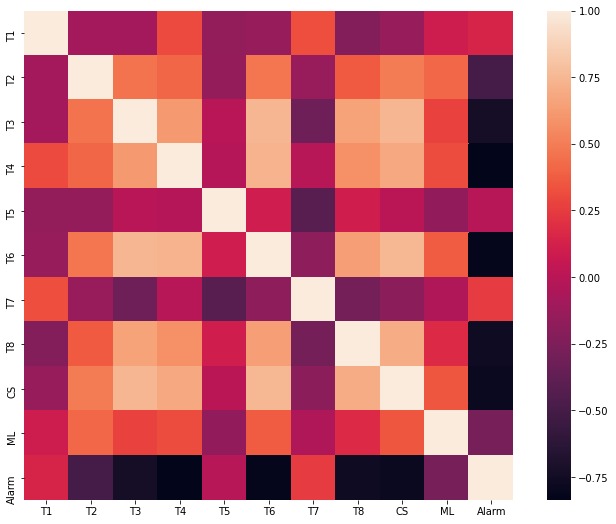

In [ ]:
#correlation matrix
corrmat = dataset.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=1, square=True);

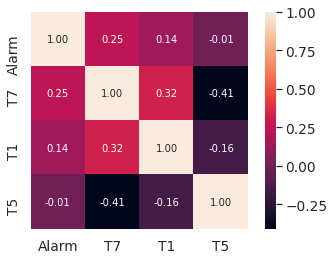

In [ ]:
k = 4 #number of variables for heatmap
cols = corrmat.nlargest(k, 'Alarm')['Alarm'].index
cm = np.corrcoef(dataset[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(cm, cbar=True, annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

Making a pair plot of all the features using seaborn.

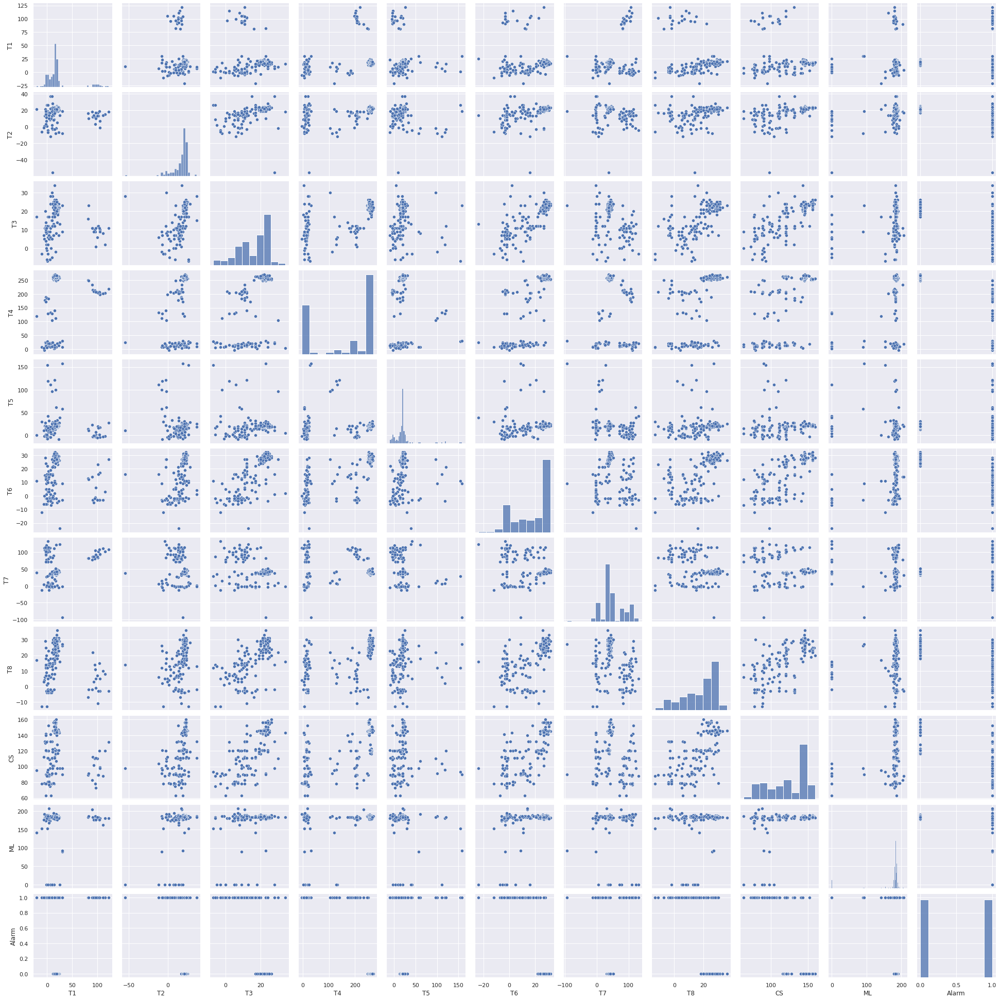

In [ ]:
sns.set()
sns.pairplot(dataset, height = 2.5)
plt.show();

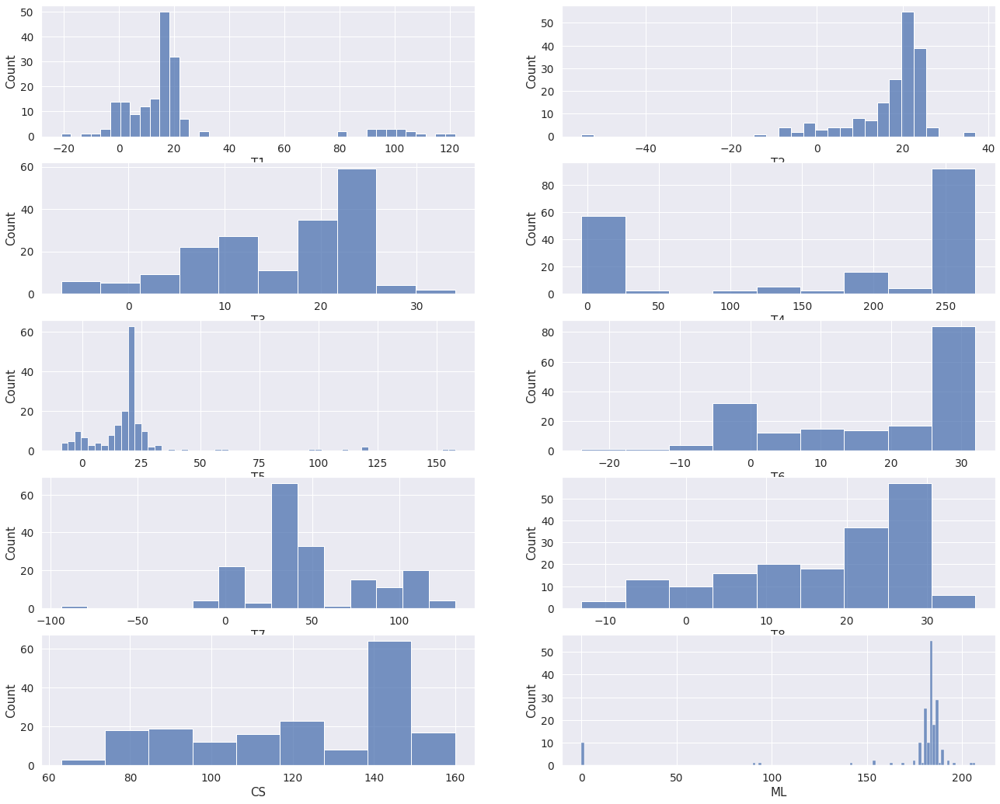

In [ ]:
fig, ax1 = plt.subplots(5,2, figsize=(22,18))
k = 0
columns = list(dataset.columns)
for i in range(5):
    for j in range(2):
            sns.histplot(dataset[columns[k]], ax = ax1[i][j])
            k += 1
plt.show()

In [ ]:
from scipy.stats import norm, skew

In [ ]:
feats = ['T1','T2','T3','T4','T5','T6','T7','T8','CS','ML']
skewed_feats = dataset[feats].apply(lambda x: skew(x.dropna())).sort_values(ascending=False)
print("\nSkew in numerical features: \n")
skewness = pd.DataFrame({'Skew' :skewed_feats})
skewness


Skew in numerical features: 



,Skew
T5,3.576211
T1,2.217207
T7,0.097964
CS,-0.459519
T4,-0.557738
T6,-0.699770
T3,-0.756970
T8,-0.796498
T2,-2.853046
ML,-3.540345


In [ ]:
skewness = skewness[abs(skewness) > 0.75]
print("There are {} skewed numerical features to Box Cox transform".format(skewness.shape[0]))

from scipy.special import boxcox1p
skewed_features = skewness.index
lam = 0.15
for feat in skewed_features:
    dataset[feat] = boxcox1p(dataset[feat], lam)

There are 10 skewed numerical features to Box Cox transform


In [ ]:
dataset.fillna(dataset.mean(),inplace=True)

In [ ]:
X = dataset.iloc[:, 0:10].values
y = dataset.iloc[:, 10].values

In [ ]:
dataset.isnull().sum()

T1       0
T2       0
T3       0
T4       0
T5       0
T6       0
T7       0
T8       0
CS       0
ML       0
Alarm    0
dtype: int64

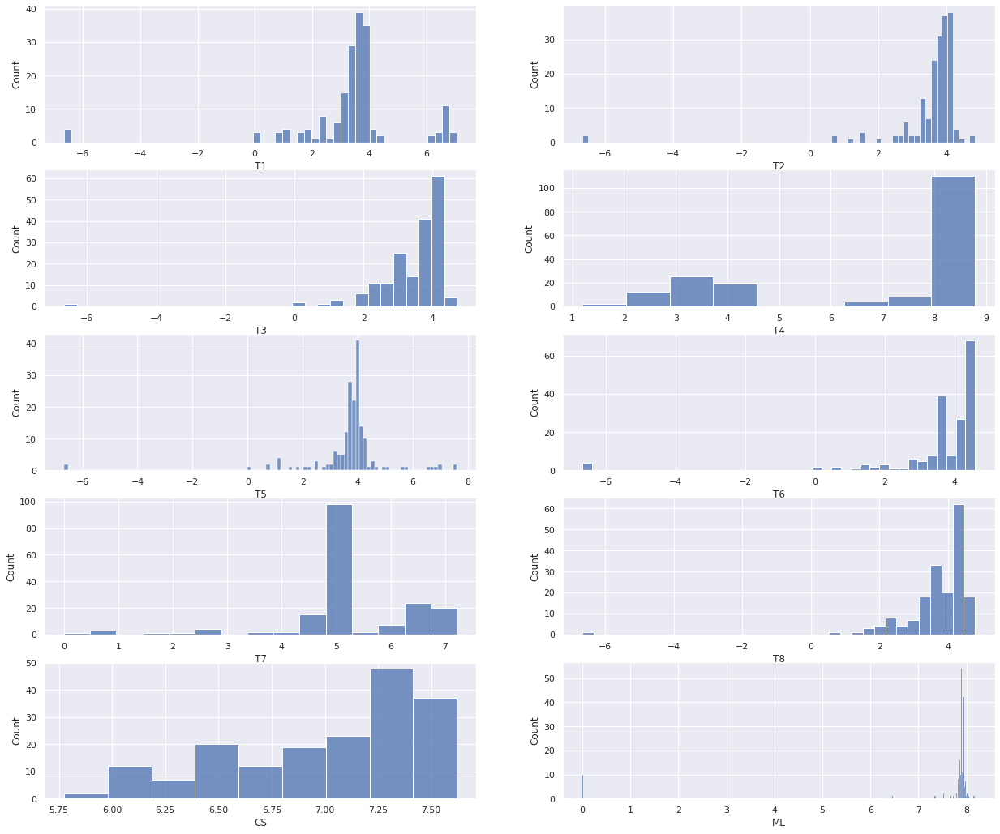

In [ ]:
fig, ax1 = plt.subplots(5,2, figsize=(21,18))
k = 0
columns = list(dataset.columns)
for i in range(5):
    for j in range(2):
            sns.histplot(dataset[columns[k]], ax = ax1[i][j])
            k += 1
plt.show()

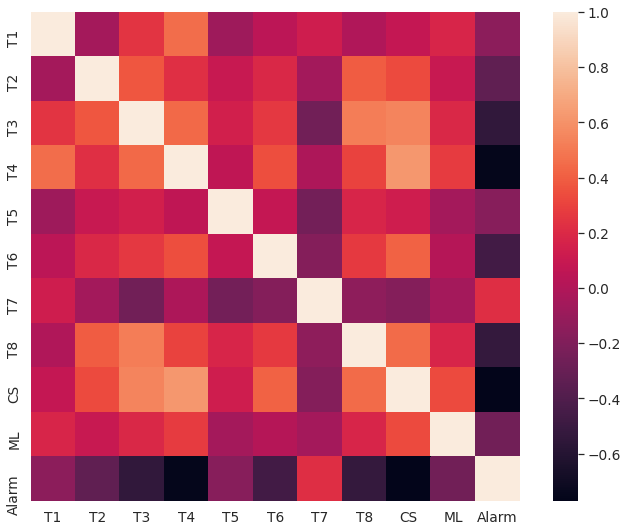

In [ ]:
#correlation matrix
corrmat = dataset.corr()
f, ax = plt.subplots(figsize=(12, 9))
sns.heatmap(corrmat, vmax=1, square=True);

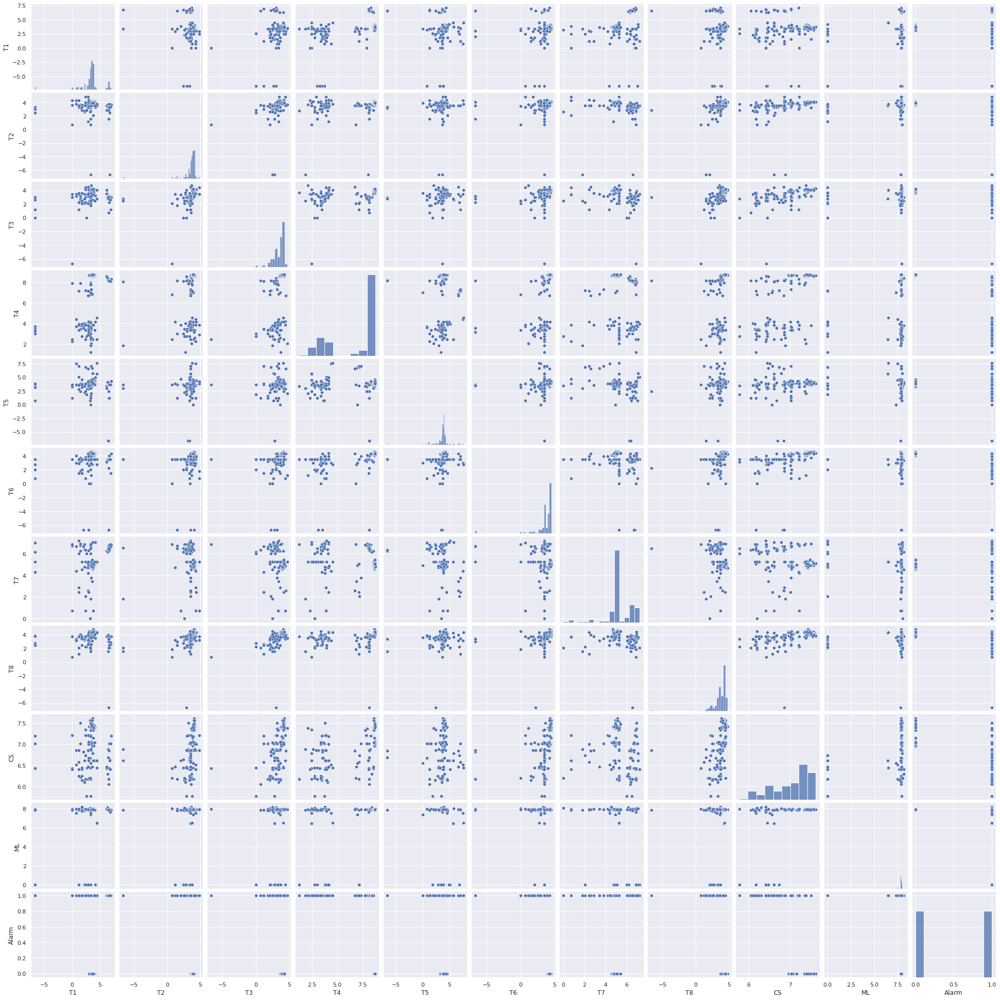

In [ ]:
sns.set()
sns.pairplot(dataset, height = 2.5)
plt.show();

In [ ]:
X

array([[ 2.25967379,  2.60259447,  2.05564154, ...,  3.2377282 ,
         6.14846083,  7.79986587],
       [ 6.75185342,  2.44026838,  2.88584647, ...,  3.72876814,
         6.6350821 ,  7.87320345],
       [ 6.75185342, -6.66666667,  2.7502503 , ...,  2.05564154,
         6.61504415,  7.87320345],
       ...,
       [ 3.53041926,  4.00341925,  4.00341925, ...,  4.26316078,
         7.42642709,  7.94450293],
       [ 3.53041926,  3.93251029,  4.13771064, ...,  4.38094603,
         7.44076639,  7.90910024],
       [ 3.78205692,  3.93251029,  4.20146129, ...,  4.4372688 ,
         7.39749796,  7.90910024]])

In [ ]:
y

array([1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0])

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X ,y ,test_size=0.2,random_state = seed)

In [ ]:
X_train.shape

(144, 10)

In [ ]:
X_test.shape

(36, 10)

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()

In [ ]:
X_train = sc.fit_transform(X_train)
X_test = sc.fit_transform(X_test)

In [ ]:
from tensorflow import keras
from tensorflow.keras import layers

In [ ]:
X_train[0]

array([-0.53987351,  0.54044767, -0.56298002, -1.35272375, -1.17835559,
        0.20224708,  0.92494796, -1.85376715, -1.64115006,  0.30403878])

In [ ]:
X_train.shape[1]

10

In [ ]:
# from tensorflow.keras import layers, callbacks

# early_stopping = callbacks.EarlyStopping(
#     min_delta=0.001, # minimium amount of change to count as an improvement
#     patience=10, # how many epochs to wait before stopping
#     restore_best_weights=True,
# )

In [ ]:
model = keras.Sequential([                     
    layers.Dense(16, activation='relu', input_shape=[X_train.shape[1]]),
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(12, activation='relu'),
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid')
])

In [ ]:
model.compile(
    # optimizer= keras.optimizers.Adam(
    # learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-07, amsgrad=False,
    # name='Adam'),
    optimizer= 'Adam',
    loss='binary_crossentropy',
    metrics=['accuracy'],
)
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
history = model.fit(
    X_train, y_train,
    validation_data=(X_test, y_test),
    batch_size=16,
    epochs=100,
    # callbacks=[early_stopping],
    callbacks=[tensorboard_callback],
    )

Epoch 1/100
9/9 [==============================] - 1s 36ms/step - loss: 1.2622 - accuracy: 0.3022 - val_loss: 0.8939 - val_accuracy: 0.5278
Epoch 2/100
9/9 [==============================] - 0s 7ms/step - loss: 1.0844 - accuracy: 0.4012 - val_loss: 0.8501 - val_accuracy: 0.5833
Epoch 3/100
9/9 [==============================] - 0s 7ms/step - loss: 0.8861 - accuracy: 0.4950 - val_loss: 0.8047 - val_accuracy: 0.5556
Epoch 4/100
9/9 [==============================] - 0s 6ms/step - loss: 0.9591 - accuracy: 0.4672 - val_loss: 0.7569 - val_accuracy: 0.5556
Epoch 5/100
9/9 [==============================] - 0s 6ms/step - loss: 0.6715 - accuracy: 0.6188 - val_loss: 0.7070 - val_accuracy: 0.5833
Epoch 6/100
9/9 [==============================] - 0s 9ms/step - loss: 0.7853 - accuracy: 0.5886 - val_loss: 0.6543 - val_accuracy: 0.6944
Epoch 7/100
9/9 [==============================] - 0s 8ms/step - loss: 0.7231 - accuracy: 0.5994 - val_loss: 0.6034 - val_accuracy: 0.7500
Epoch 8/100
9/9 [=========

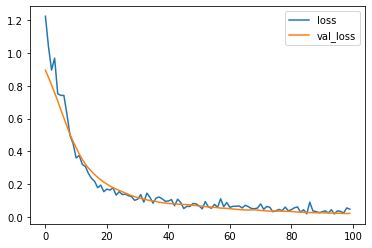

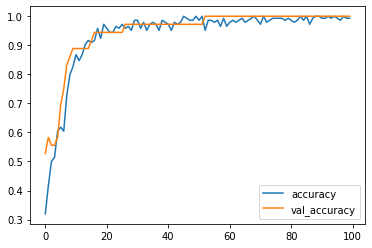

In [ ]:
history_df = pd.DataFrame(history.history)
history_df.loc[:, ['loss', 'val_loss']].plot()
history_df.loc[:, ['accuracy', 'val_accuracy']].plot()

In [ ]:
print("Minimum Test Loss: {:0.4f}".format(history_df['val_loss'].min()))
print("Highest Test Accuracy: {:0.4f}".format(history_df['val_accuracy'].max()))

Minimum Test Loss: 0.0227
Highest Test Accuracy: 1.0000


In [ ]:
print("Minimum Train Loss: {:0.4f}".format(history_df['loss'].min()))
print("Highest Train Accuracy: {:0.4f}".format(history_df['accuracy'].max()))

Minimum Train Loss: 0.0204
Highest Train Accuracy: 1.0000


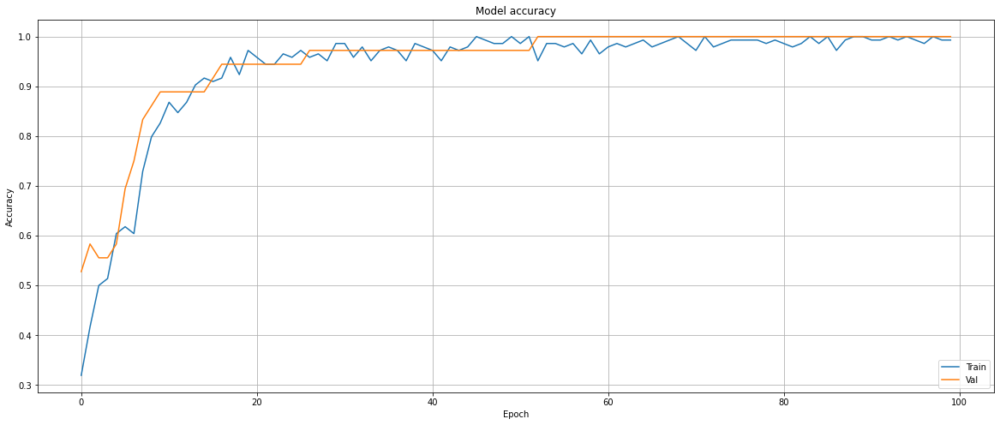

In [ ]:
 # showing a plot of how Accurate the model is against the 
# test dataset
plt.figure(figsize=(20, 8))
plt.grid(True)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='lower right')
plt.show()

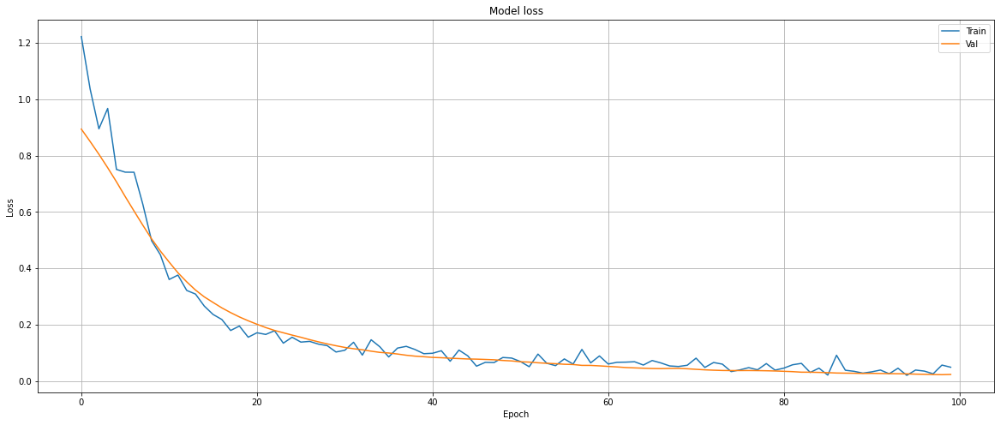

In [ ]:
# showing a plot of the loss with respect to the number of epochs 
plt.figure(figsize=(20, 8))
plt.grid(True)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Val'], loc='upper right')
plt.show() 

In [ ]:
y_test

array([0, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 0, 0])

In [ ]:
y_pred = model.predict(X_test)

In [ ]:
y_pred = np.round(y_pred)

In [ ]:
y_pred[:10]

array([[0.],
       [1.],
       [1.],
       [0.],
       [1.],
       [0.],
       [0.],
       [0.],
       [1.],
       [1.]], dtype=float32)

In [ ]:
y_test[:10]

array([0, 1, 1, 0, 1, 0, 0, 0, 1, 1])

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 16)                176       
_________________________________________________________________
batch_normalization (BatchNo (None, 16)                64        
_________________________________________________________________
dropout (Dropout)            (None, 16)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 12)                204       
_________________________________________________________________
batch_normalization_1 (Batch (None, 12)                48        
_________________________________________________________________
dropout_1 (Dropout)          (None, 12)                0         
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 1

In [ ]:
!kill 415

In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 799), started 0:06:36 ago. (Use '!kill 799' to kill it.)

<IPython.core.display.Javascript object>